<center><img src="https://github.com/DACSS-CSSmeths/guidelines/blob/main/pics/small_logo_ccs_meths.jpg?raw=true" width="700"></center>

<a target="_blank" href="https://colab.research.google.com/github/DACSS-CSSmeths/Spatial-Exploring/blob/main/index.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

# Spatial Data Exploration


The exploration of data using maps is a key first step during the analytical process. However, this is not as easy as it may seem.
Let me get some data organised by the [CIA](https://www.cia.gov/the-world-factbook/references/guide-to-country-comparisons/):

* Tobacco Use
* Alcohol Comsumption
* Obesity in Adults
* Population
* Area

The data is on GitHub:


In [4]:
mainLink='https://github.com/DACSS-CSSmeths/Spatial-Exploring/raw/refs/heads/main/'

tobLink='dataCIA/Tobacco_use.csv'
alcLink='dataCIA/Alcohol_consumptionPerCapita.csv'
obeLink='dataCIA/Obesity_adultPrevalenceRate.csv'
popLink='dataCIA/Population_total.csv'
areaLink='dataCIA/Area.csv'

import pandas as pd

tobDat=pd.read_csv(mainLink+tobLink)
alcDat=pd.read_csv(mainLink+alcLink)
obeDat=pd.read_csv(mainLink+obeLink)
popDat=pd.read_csv(mainLink+popLink)
areaDat=pd.read_csv(mainLink+areaLink)


# num of rows
tobDat.shape[0],alcDat.shape[0], obeDat.shape[0],popDat.shape[0],areaDat.shape[0]

(164, 189, 192, 237, 256)

As you see, the amount of countries (rows) in each data  is different from the others.

## The data merging


We need one data frame after merging all of them, the result has problematic
column names:

In [5]:
allCia=obeDat.merge(tobDat.merge(alcDat,on='name'),on='name')
allCia.columns

Index(['name', 'obesityAdults_rate', 'region', 'TobaccoUse_perc', 'region_x',
       'Alcohol_LitersPerCap', 'region_y'],
      dtype='object')

Notice that preprocesing concepts are always needed in any project. In this case:
* **name** column appears once, it was the key column for the merging of the three data sets.
* **region** was not a key column, but it appeared in all the data frames; so, the column is repeated with a suffix at the end (_x,_y). Notice that **_x** refers to the location of the object related to the _merge()_ function:**left.merge(right)**

We will simply subset in this case:

In [6]:
# subsetting
allCia=allCia.loc[:,['name','region','obesityAdults_rate','TobaccoUse_perc','Alcohol_LitersPerCap']]

# check data types
allCia.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 162 entries, 0 to 161
Data columns (total 5 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   name                  162 non-null    object 
 1   region                162 non-null    object 
 2   obesityAdults_rate    162 non-null    float64
 3   TobaccoUse_perc       162 non-null    float64
 4   Alcohol_LitersPerCap  162 non-null    float64
dtypes: float64(3), object(2)
memory usage: 6.5+ KB


Notice that the resulting dataframe got even less countries than any of the other ones after the merge. You would need to apply _fuzzy merge_ if you want to recover some rows during the merge. The **good** news is that the columns are in the rigth data type. Please review my previous [**work**](https://www.cambridge.org/core/books/introduction-to-data-science-for-social-and-policy-research/6C0566972D7132CE8ACFBD7F97954D87) if these two concepts were not familiar to you.

Let me prepare another merge:

In [7]:
poparea=popDat.merge(areaDat, on=['name','region'])
poparea

,name,Population_total,region,area_SqKm
0,China,"1,416,043,270",East and Southeast Asia,"9,596,960"
1,India,"1,409,128,296",South Asia,"3,287,263"
2,United States,"341,963,408",North America,"9,833,517"
3,Indonesia,"281,562,465",East and Southeast Asia,"1,904,569"
4,Pakistan,"252,363,571",South Asia,"796,095"
...,...,...,...,...
232,Tokelau,"1,647",Australia and Oceania,12
233,Paracel Islands,"1,440",East and Southeast Asia,8
234,Holy See (Vatican City),"1,000",Europe,0
235,Cocos (Keeling) Islands,593,Australia and Oceania,14


Notice that I used TWO keys this time. This avoid the previous column suffixes.
Let's see the data types:

In [8]:
poparea.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 237 entries, 0 to 236
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   name              237 non-null    object
 1   Population_total  237 non-null    object
 2   region            237 non-null    object
 3   area_SqKm         237 non-null    object
dtypes: object(4)
memory usage: 7.5+ KB


As you may have guessed, the numeric columns are not properly recognized as such. You may need to delete the commas and turn the columns into a numerical data type, or just reload the data with other arguments:

In [9]:
popDat=pd.read_csv(mainLink+popLink, thousands=',')
areaDat=pd.read_csv(mainLink+areaLink, thousands=',')

Now we have it right!

In [10]:
poparea=popDat.merge(areaDat, on=['name','region'])
poparea.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 237 entries, 0 to 236
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   name              237 non-null    object
 1   Population_total  237 non-null    int64 
 2   region            237 non-null    object
 3   area_SqKm         237 non-null    int64 
dtypes: int64(2), object(2)
memory usage: 7.5+ KB


## Geo Merging

Remember we created these maps the previous week:

In [11]:
import geopandas as gpd

mapsLink=mainLink+'maps/worldMaps_Py.gpkg'



# just the list of maps
gpd.list_layers(mapsLink)


,name,geometry_type
0,countries_poly,MultiPolygon
1,rivers_line,MultiLineString
2,cities_point,Point


Let's open the **countries_poly**  map:

In [12]:
countries=gpd.read_file(mapsLink, layer='countries_poly')
countries.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 252 entries, 0 to 251
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   COUNTRY   252 non-null    object  
 1   geometry  252 non-null    geometry
dtypes: geometry(1), object(1)
memory usage: 4.1+ KB


Let's see some contents:

In [13]:
countries.head()

,COUNTRY,geometry
0,Aruba (Netherlands),"MULTIPOLYGON (((-69.88223 12.41111, -69.94695 ..."
1,Antigua and Barbuda,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ..."
2,Afghanistan,"MULTIPOLYGON (((61.27656 35.60725, 61.29638 35..."
3,Algeria,"MULTIPOLYGON (((-5.15213 30.18047, -5.13917 30..."
4,Azerbaijan,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38..."


This map has no interesting information beyond the geometry, which, as we know, serves to plot the polygons.

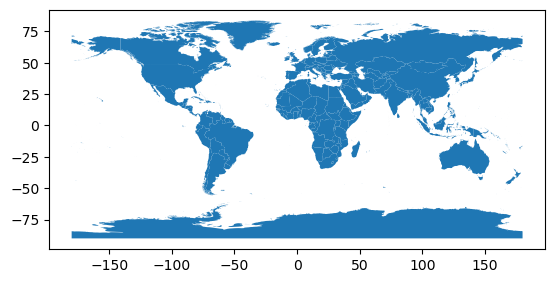

In [14]:
import matplotlib.pyplot as plt

countries.plot()
plt.show();

Then, let's add the population data to the map.

Notice that when geoMerging, the map object has to be the LEFT object: **GEO_DF.merge(DF)**

In [15]:
mapPopu=countries.merge(poparea, left_on='COUNTRY', right_on='name')
mapPopu.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 174 entries, 0 to 173
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   COUNTRY           174 non-null    object  
 1   geometry          174 non-null    geometry
 2   name              174 non-null    object  
 3   Population_total  174 non-null    int64   
 4   region            174 non-null    object  
 5   area_SqKm         174 non-null    int64   
dtypes: geometry(1), int64(2), object(3)
memory usage: 8.3+ KB


Notice that the merge has now less COUNTRIES. You should consider fuzzy merge to reduce missing values.

Let me color the polygons using the population data:

<Axes: >

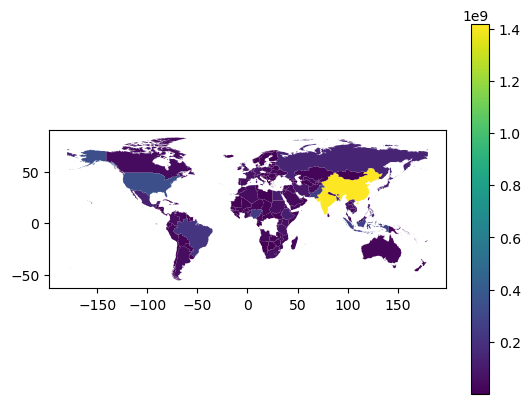

In [16]:
mapPopu.plot(column='Population_total',legend=True)

Is it that simple? Not really. Of course is not a difficult task. After you have read the recommended reading ([Herries, 2018](https://www.esri.com/about/newsroom/arcuser/understanding-statistical-data-for-mapping-purposes/)), you should know that population is a count, an example of extensive statistics, and we should process data so that they represent intensive stats when plotted. Let's compute population density, as density is an intensive stat:

In [17]:
mapPopu['popDensity']=mapPopu.Population_total/mapPopu.area_SqKm

# Choropleths

Are we ready for a choropleth? the **popDensity** we just created is an intensive stat. Lets' see its distribution:

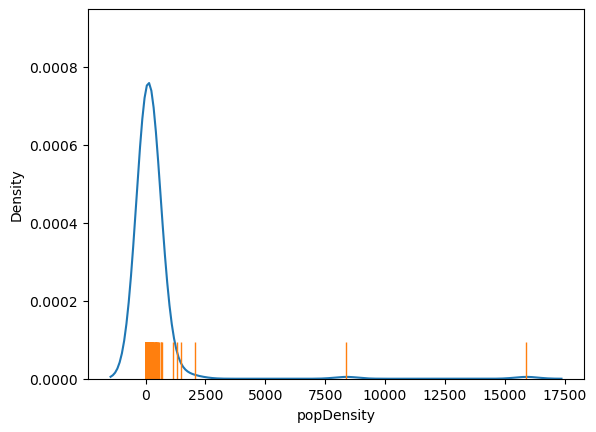

In [18]:
import seaborn as sea

sea.kdeplot(data=mapPopu, x="popDensity")
sea.rugplot(data=mapPopu, x="popDensity",height=.1)

plt.show()

Then, you know that outliers are present, let's sort the data:

In [19]:
mapPopu.sort_values(by=['popDensity'],ascending=False)

,COUNTRY,geometry,name,Population_total,region,area_SqKm,popDensity
97,Monaco,"MULTIPOLYGON (((7.39161 43.72755, 7.3909 43.74...",Monaco,31813,Europe,2,15906.500000
139,Singapore,"MULTIPOLYGON (((103.99054 1.38329, 103.99795 1...",Singapore,6028459,East and Southeast Asia,719,8384.504868
11,Bahrain,"MULTIPOLYGON (((50.65055 26.24472, 50.61305 26...",Bahrain,1566888,Middle East,760,2061.694737
101,Malta,"MULTIPOLYGON (((14.51972 35.8, 14.42389 35.818...",Malta,469730,Europe,316,1486.487342
103,Maldives,"MULTIPOLYGON (((72.97998 7.02778, 72.98272 7.0...",Maldives,388858,South Asia,298,1304.892617
...,...,...,...,...,...,...,...
63,Guyana,"MULTIPOLYGON (((-60.08087 5.16151, -60.08195 5...",Guyana,794099,South America,214969,3.694016
68,Iceland,"MULTIPOLYGON (((-22.02472 64.41888, -22.02444 ...",Iceland,364036,Europe,103000,3.534330
9,Australia,"MULTIPOLYGON (((142.27997 -10.26556, 142.21053...",Australia,26768598,Australia and Oceania,7741220,3.457930
168,Namibia,"MULTIPOLYGON (((14.52485 -22.69207, 14.5274 -2...",Namibia,2803660,Africa,824292,3.401295


Outliers will make the coloring challenging:

<Axes: >

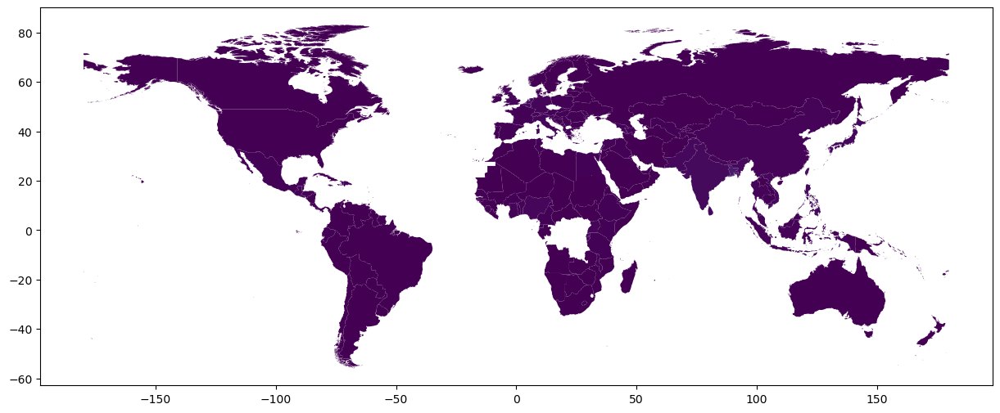

In [20]:
# find Monaco and Singapur!
mapPopu.plot(column='popDensity',figsize=(15,25))

Given this behavior, we could experiment with some transformation:

<Axes: >

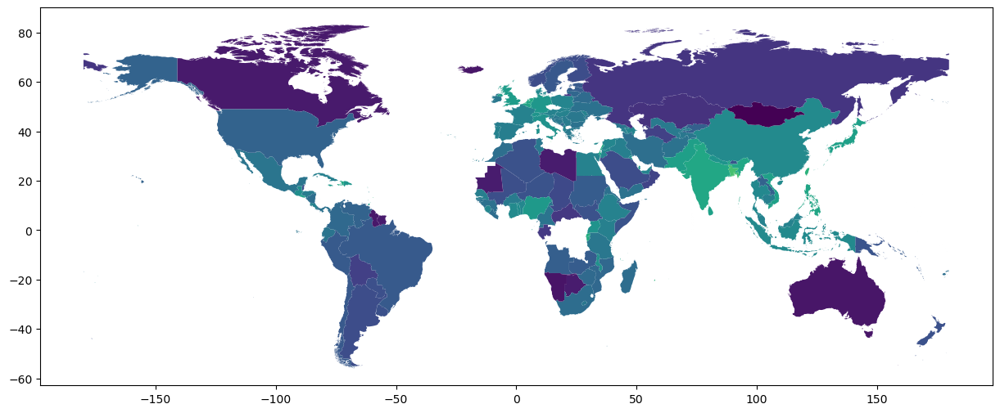

In [21]:
import numpy as np

#log of var
mapPopu['popDensity_log10']=np.log10(mapPopu.popDensity)
mapPopu.plot(column='popDensity_log10',figsize=(15,25))

As I shared at the begining, we need some thinking before coloring the polygons so that it can be an interesteting and useful choropleth.

## A Choropleth for CONTINUOUS values

Let me use the other variables we have to create a new map:

In [22]:
countriesCIA=countries.merge(allCia, left_on='COUNTRY', right_on='name')
countriesCIA.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 147 entries, 0 to 146
Data columns (total 7 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   COUNTRY               147 non-null    object  
 1   geometry              147 non-null    geometry
 2   name                  147 non-null    object  
 3   region                147 non-null    object  
 4   obesityAdults_rate    147 non-null    float64 
 5   TobaccoUse_perc       147 non-null    float64 
 6   Alcohol_LitersPerCap  147 non-null    float64 
dtypes: float64(3), geometry(1), object(3)
memory usage: 8.2+ KB


The merge gave us again a GeoDF, let's see the distribution of Tobacco use:

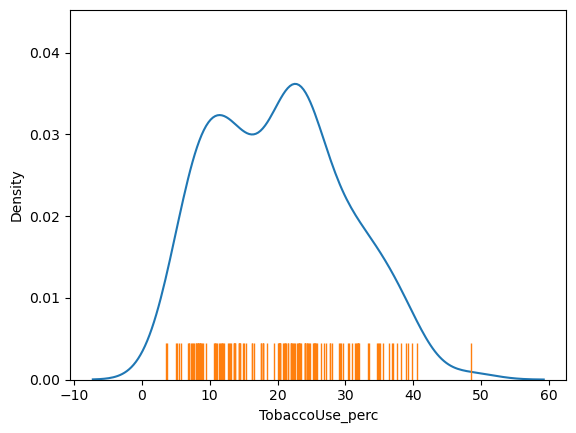

In [23]:
sea.kdeplot(data=countriesCIA, x="TobaccoUse_perc")
sea.rugplot(data=countriesCIA, x="TobaccoUse_perc",height=.1)

plt.show()

Now the map:

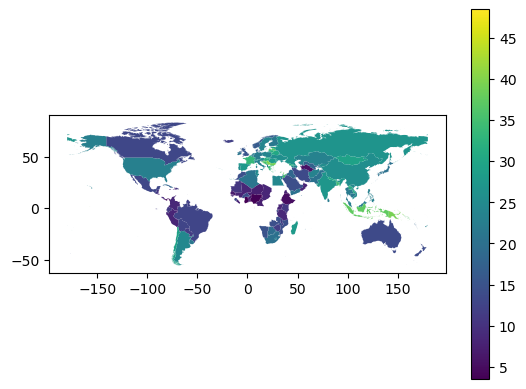

In [24]:
countriesCIA.plot(column='TobaccoUse_perc',legend=True)
plt.show();

The variable has already been transformed, and represent an intensive stat. But this is not the best we can do  (review the recommended [reading](https://www.esri.com/arcgis-blog/products/arcgis-online/mapping/better-breaks-define-your-thematic-maps-purpose/))::

* We are allowing the program to choose the color palette.
* We are not clarifying that we have missing values.
* The axes coordinates may not be needed.
* We have too many shades of colors. Discretization may be needed.


In [68]:
## Choropleths of Adult Obesity

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 147 entries, 0 to 146
Data columns (total 7 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   COUNTRY               147 non-null    object  
 1   geometry              147 non-null    geometry
 2   name                  147 non-null    object  
 3   region                147 non-null    object  
 4   obesityAdults_rate    147 non-null    float64 
 5   TobaccoUse_perc       147 non-null    float64 
 6   Alcohol_LitersPerCap  147 non-null    float64 
dtypes: float64(3), geometry(1), object(3)
memory usage: 8.2+ KB


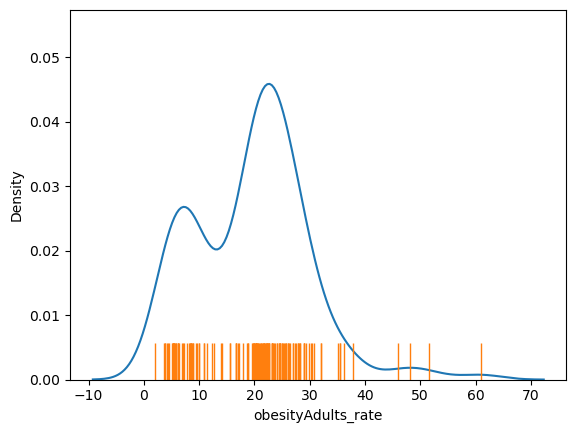

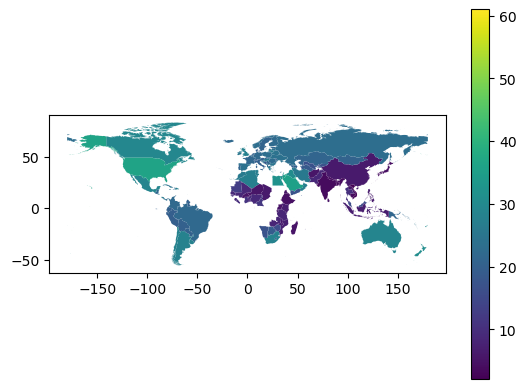

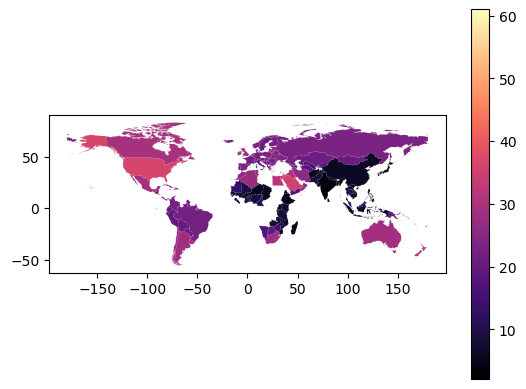

In [66]:
countriesCIA=countries.merge(allCia, left_on='COUNTRY', right_on='name')
countriesCIA.info()

sea.kdeplot(data=countriesCIA, x="obesityAdults_rate")
sea.rugplot(data=countriesCIA, x="obesityAdults_rate",height=.1)

plt.show()

countriesCIA.plot(column='obesityAdults_rate',legend=True)
plt.show();

countriesCIA.plot(column='obesityAdults_rate',legend=True,cmap='magma')
plt.show();

In [54]:
countries.dissolve()

,geometry,COUNTRY
0,"MULTIPOLYGON (((-159.77335 -79.86084, -159.924...",Aruba (Netherlands)


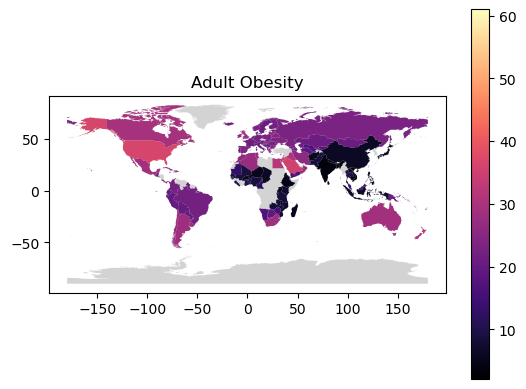

In [55]:
worldBorders=countries.dissolve() # saving the dissolved map

# plotting two layers:
base=worldBorders.plot(color='lightgrey') # layer 1
countriesCIA.plot(column='obesityAdults_rate',legend=True,cmap='magma',
                  ax=base) # layer 2, on top on layer 1
base.set_title("Adult Obesity")
plt.show();

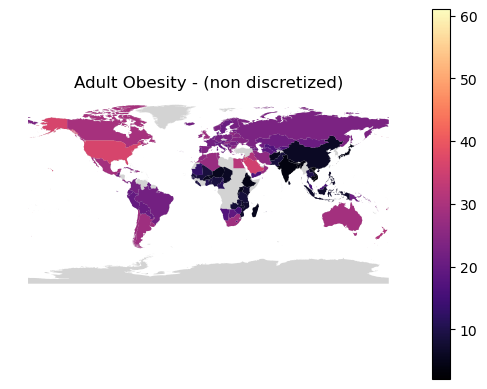

In [56]:
base=worldBorders.plot(color='lightgrey')
countriesCIA.plot(column='obesityAdults_rate',
                  legend=True,
                  cmap='magma',
                  ax=base)
# here!
base.set_title("Adult Obesity - (non discretized)")
base.set_axis_off()


plt.show();

In [69]:
## A Choropleth for DISCRETIZED values (Adult Obesity)

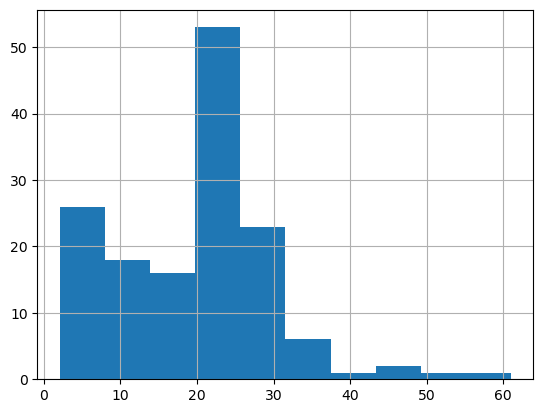

In [57]:
countriesCIA.loc[:,'obesityAdults_rate'].hist()
plt.show();

In [70]:
## The bining schemes

In [84]:
import mapclassify
import numpy as np

np.random.seed(12345) # so we all get the same results!

# let's try 5 bins
K=5
theVar=countriesCIA.obesityAdults_rate


# same interval width, easy interpretation
ei5 = mapclassify.EqualInterval(theVar, k=K)
# same interval width based on standard deviation, easy - but not as the previous one, poor when high skewness
msd = mapclassify.StdMean(theVar)
# interval width varies, counts per interval are close, not easy to grasp, repeated values complicate cuts
q5=mapclassify.Quantiles(theVar,k=K)
# based on similarity, good for multimodal data
mb5 = mapclassify.MaximumBreaks(theVar, k=K)
# based on similarity, optimizer
fj5 = mapclassify.FisherJenks(theVar, k=K)
# based on similarity, optimizer
jc5 = mapclassify.JenksCaspall(theVar, k=K)
# based on similarity, optimizer
mp5 = mapclassify.MaxP(theVar, k=K)

###### based on similarity, good for skewed data
ht = mapclassify.HeadTailBreaks(theVar) # no K needed

In [85]:
class5 = ei5,msd, q5,mb5,  ht, fj5, jc5, mp5
# Collect ADCM for each classifier
fits = np.array([ c.adcm for c in class5])
# Convert ADCM scores to a DataFrame
adcms = pd.DataFrame(fits)
# Add classifier names
adcms['classifier'] = [c.name for c in class5]
# Add column names to the ADCM
adcms.columns = ['ADCM', 'Classifier']

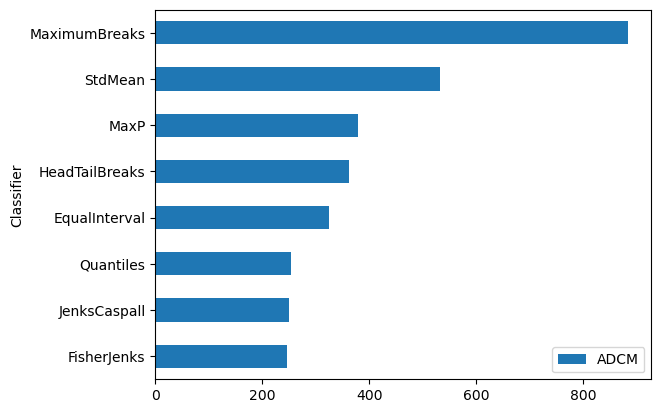

In [74]:
adcms.sort_values('ADCM').plot.barh(x='Classifier')
plt.show();

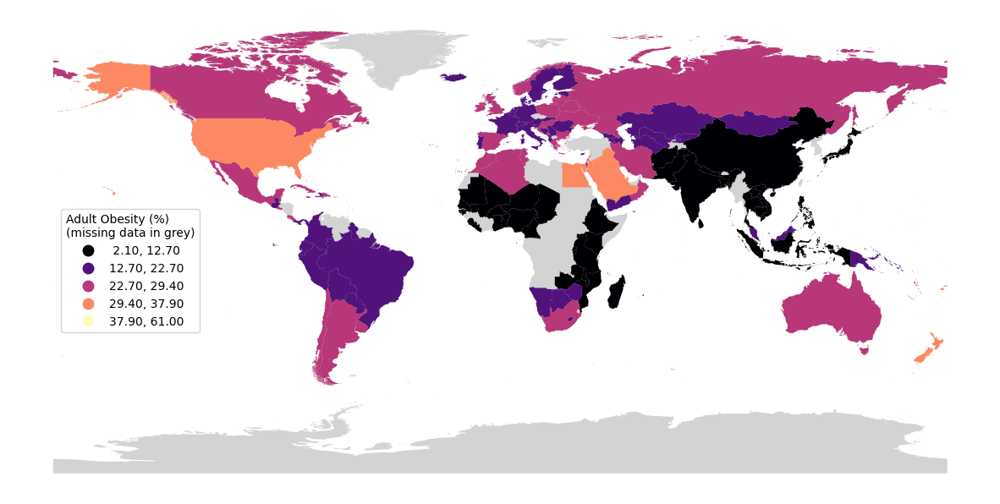

In [86]:
base=worldBorders.plot(color='lightgrey',
                     figsize=(15, 10))
countriesCIA.plot(column='obesityAdults_rate', cmap='magma', ax=base,
                     scheme="fisher_jenks",
                     linewidth=0.,
                     legend=True,
                     legend_kwds={"title": "Adult Obesity (%)\n(missing data in grey)"}
                   )
leg = base.get_legend()
leg.set_bbox_to_anchor((0.2, 0.6)) #(left, bottom)
base.set_axis_off()
plt.show();

In [87]:
# the code assigned to each country
fj5.yb

array([0, 2, 1, 1, 1, 2, 2, 2, 1, 3, 2, 1, 1, 0, 2, 1, 1, 0, 2, 1, 1, 2,
       1, 0, 2, 0, 0, 0, 0, 2, 0, 0, 1, 2, 2, 1, 1, 2, 1, 3, 2, 1, 0, 2,
       0, 1, 3, 1, 1, 0, 1, 2, 1, 1, 1, 2, 2, 1, 0, 2, 2, 1, 3, 0, 2, 3,
       0, 1, 4, 3, 1, 0, 3, 2, 2, 0, 1, 1, 1, 0, 1, 1, 0, 0, 2, 0, 0, 2,
       2, 0, 2, 2, 1, 0, 0, 2, 0, 1, 2, 0, 4, 3, 1, 1, 0, 2, 1, 1, 1, 0,
       3, 1, 0, 2, 0, 3, 1, 2, 0, 1, 0, 0, 2, 1, 1, 1, 0, 4, 0, 0, 2, 4,
       1, 0, 0, 2, 2, 3, 0, 2, 1, 0, 1, 1, 0, 1, 0])

In [88]:
# the frequency table with the breaks
fj5.table

<bound method MapClassifier.table of FisherJenks

   Interval      Count
----------------------
[ 2.10, 12.70] |    44
(12.70, 22.70] |    50
(22.70, 29.40] |    38
(29.40, 37.90] |    11
(37.90, 61.00] |     4>

In [89]:
# new variable
countriesCIA['obesity_code']=fj5.yb

# create 'obesity_levels' as a copy of 'obesity_code'
countriesCIA=countriesCIA.assign(obesity_levels=countriesCIA.obesity_code)

In [90]:
# map of labels for the levels
newLevels={0:'1.very low',1:'2.low', 2:'3.average',3:'4.high', 4:'5.very high'}

# recoding
countriesCIA.replace({'obesity_levels':newLevels}, inplace=True)

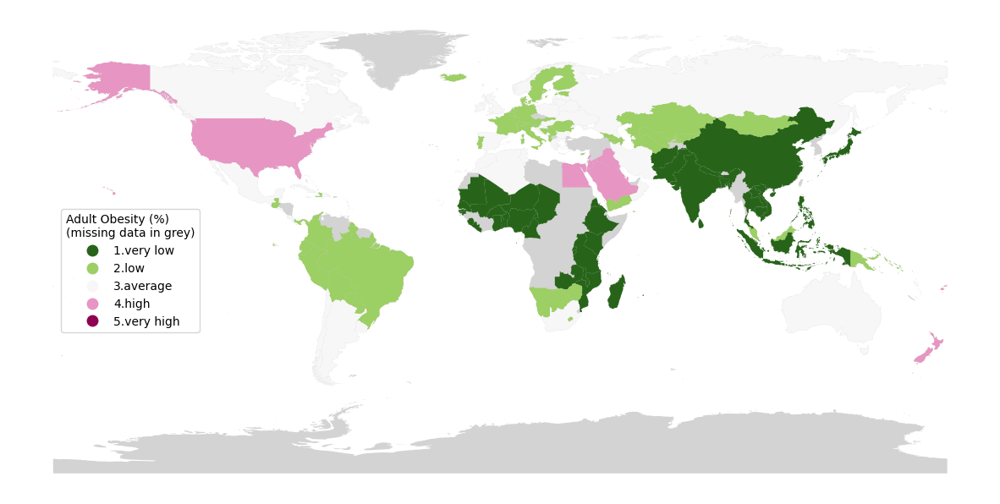

In [91]:
base=worldBorders.plot(color='lightgrey',
                     figsize=(15, 10))
countriesCIA.plot(column='obesity_levels',ax=base,
                     cmap='PiYG_r', # reversed
                     categorical=True,
                     linewidth=0.,
                     legend=True,
                     legend_kwds={"title": "Adult Obesity (%)\n(missing data in grey)"}
                   )
base.set_axis_off()

# locating the legend
leg = base.get_legend()
leg.set_bbox_to_anchor((0.2, 0.6)) #(left, bottom), 1 is max value (right/top)

plt.show();

In [92]:
### Custom bins

In [93]:
countriesCIA.obesityAdults_rate.describe()

count    147.000000
mean      19.506122
std       10.253340
min        2.100000
25%        9.750000
50%       20.800000
75%       25.100000
max       61.000000
Name: obesityAdults_rate, dtype: float64

In [95]:
customBreaks=[0,5,15,30,40,100]
pd.cut(countriesCIA.obesityAdults_rate, customBreaks,ordered=True,include_lowest=True).value_counts(sort=False)

obesityAdults_rate
(-0.001, 5.0]     8
(5.0, 15.0]      38
(15.0, 30.0]     87
(30.0, 40.0]     10
(40.0, 100.0]     4
Name: count, dtype: int64

In [96]:
theCustomLabels=['1. below5','2.(5-15]','3.(15-30]','4. (30-40]' , '5. above40']
countriesCIA['obesity_custom']=pd.cut(countriesCIA.obesityAdults_rate,
                                         customBreaks,
                                         ordered=True,
                                         include_lowest=True,
                                         labels=theCustomLabels)
countriesCIA.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 147 entries, 0 to 146
Data columns (total 10 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   COUNTRY               147 non-null    object  
 1   geometry              147 non-null    geometry
 2   name                  147 non-null    object  
 3   region                147 non-null    object  
 4   obesityAdults_rate    147 non-null    float64 
 5   TobaccoUse_perc       147 non-null    float64 
 6   Alcohol_LitersPerCap  147 non-null    float64 
 7   obesity_code          147 non-null    int32   
 8   obesity_levels        147 non-null    object  
 9   obesity_custom        147 non-null    category
dtypes: category(1), float64(3), geometry(1), int32(1), object(4)
memory usage: 10.2+ KB


In [101]:
## Interactive Map Adult Obesity

In [97]:
pip install folium matplotlib mapclassify

In [99]:
countriesCIA.explore(
    column="obesity_levels",  # make choropleth based on "fisherJenks_levels" column
    tooltip=["name","obesityAdults_rate"],  # what to show on hover
    tiles="CartoDB positron",  # use "CartoDB positron" tiles
    cmap="magma",  # colormap
    style_kwds=dict(color="black"),  # use black outline
    legend_kwds={'caption':'Adult Obesity<br>(missing has no tooltip)'}
)

In [100]:
## Creating layers from the discrete values

In [103]:
countriesCIA_good=countriesCIA[countriesCIA.obesity_code==0]
countriesCIA_mean=countriesCIA[countriesCIA.obesity_code==2]

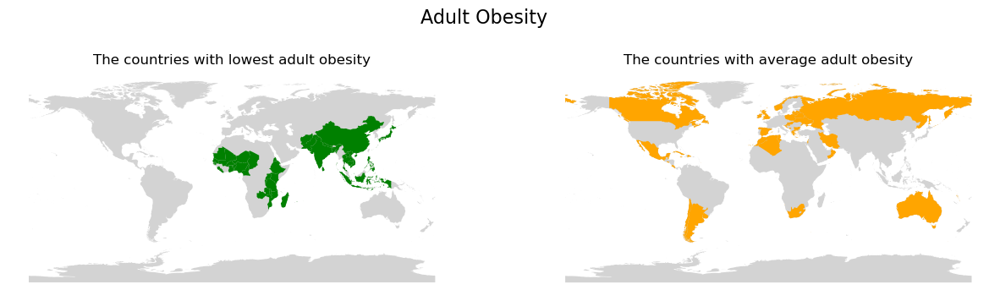

In [104]:
fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(15, 10))
# main title
fig.suptitle('Adult Obesity', size=16,y=0.7)

# map1
base1=worldBorders.plot(color='lightgrey',ax=axes[0])
countriesCIA_good.plot(color='green',ax=base1)
base1.set_title('The countries with lowest adult obesity')
base1.set_axis_off()

#map2
base2=worldBorders.plot(color='lightgrey',ax=axes[1])
countriesCIA_mean.plot(color='orange',ax=base2)
base2.set_title('The countries with average adult obesity')
base2.set_axis_off()


#display
plt.show();

In [106]:
import folium # I need folium

base = countriesCIA_good.explore(
    color='green',
    tooltip=["name","obesityAdults_rate"],  # what to show on hover
    name="good",  # name of the layer in the map
)

countriesCIA_mean.explore(
    m=base,  # the 'ax'
    tooltip=["name","obesityAdults_rate"],  # what to show on hover
    color="orange",
    name="average",
)


folium.LayerControl().add_to(base)  # use folium to add layer control

base  # show map

In [108]:
countriesCIA.head()

,COUNTRY,geometry,name,region,obesityAdults_rate,TobaccoUse_perc,Alcohol_LitersPerCap,obesity_code,obesity_levels,obesity_custom
0,Afghanistan,"MULTIPOLYGON (((61.27656 35.60725, 61.29638 35...",Afghanistan,South Asia,5.5,23.3,0.01,0,1.very low,2.(5-15]
1,Algeria,"MULTIPOLYGON (((-5.15213 30.18047, -5.13917 30...",Algeria,Africa,27.4,21.0,0.59,2,3.average,3.(15-30]
2,Azerbaijan,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38...",Azerbaijan,Middle East,19.9,24.0,1.38,1,2.low,3.(15-30]
3,Albania,"MULTIPOLYGON (((20.79192 40.43154, 20.78722 40...",Albania,Europe,21.7,22.4,4.40,1,2.low,3.(15-30]
4,Armenia,"MULTIPOLYGON (((46.54037 38.87559, 46.51639 38...",Armenia,Middle East,20.2,25.5,3.77,1,2.low,3.(15-30]


In [109]:
# Beyond choroplething

In [110]:
# based on similarity, optimizer
fj5_alc = mapclassify.FisherJenks(countriesCIA.Alcohol_LitersPerCap, k=K)

# get the values
countriesCIA['alcohol_code']=fj5_alc.yb

# a copy in another column
countriesCIA=countriesCIA.assign(alcohol_levels=countriesCIA.alcohol_code)

# recoding
countriesCIA.replace({'alcohol_levels':newLevels}, inplace=True)

countriesCIA.head()

,COUNTRY,geometry,name,region,obesityAdults_rate,TobaccoUse_perc,Alcohol_LitersPerCap,obesity_code,obesity_levels,obesity_custom,alcohol_code,alcohol_levels
0,Afghanistan,"MULTIPOLYGON (((61.27656 35.60725, 61.29638 35...",Afghanistan,South Asia,5.5,23.3,0.01,0,1.very low,2.(5-15],0,1.very low
1,Algeria,"MULTIPOLYGON (((-5.15213 30.18047, -5.13917 30...",Algeria,Africa,27.4,21.0,0.59,2,3.average,3.(15-30],0,1.very low
2,Azerbaijan,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38...",Azerbaijan,Middle East,19.9,24.0,1.38,1,2.low,3.(15-30],0,1.very low
3,Albania,"MULTIPOLYGON (((20.79192 40.43154, 20.78722 40...",Albania,Europe,21.7,22.4,4.40,1,2.low,3.(15-30],2,3.average
4,Armenia,"MULTIPOLYGON (((46.54037 38.87559, 46.51639 38...",Armenia,Middle East,20.2,25.5,3.77,1,2.low,3.(15-30],1,2.low


In [111]:
countriesCIA.alcohol_levels.value_counts()

alcohol_levels
1.very low     45
2.low          31
5.very high    26
4.high         24
3.average      21
Name: count, dtype: int64

In [135]:
# based on similarity, optimizer
fj5_tob = mapclassify.FisherJenks(countriesCIA.TobaccoUse_perc, k=K)

# get the values
countriesCIA['tobacco_code']=fj5_tob.yb

# a copy in another column
countriesCIA=countriesCIA.assign(tobacco_levels=countriesCIA.tobacco_code)

# recoding
countriesCIA.replace({'tobacco_levels':newLevels}, inplace=True)

countriesCIA.head()

,COUNTRY,geometry,name,region,obesityAdults_rate,TobaccoUse_perc,Alcohol_LitersPerCap,obesity_code,obesity_levels,obesity_custom,alcohol_code,alcohol_levels,tobacco_code,tobacco_levels
0,Afghanistan,"MULTIPOLYGON (((61.27656 35.60725, 61.29638 35...",Afghanistan,South Asia,5.5,23.3,0.01,0,1.very low,2.(5-15],0,1.very low,2,3.average
1,Algeria,"MULTIPOLYGON (((-5.15213 30.18047, -5.13917 30...",Algeria,Africa,27.4,21.0,0.59,2,3.average,3.(15-30],0,1.very low,2,3.average
2,Azerbaijan,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38...",Azerbaijan,Middle East,19.9,24.0,1.38,1,2.low,3.(15-30],0,1.very low,2,3.average
3,Albania,"MULTIPOLYGON (((20.79192 40.43154, 20.78722 40...",Albania,Europe,21.7,22.4,4.40,1,2.low,3.(15-30],2,3.average,2,3.average
4,Armenia,"MULTIPOLYGON (((46.54037 38.87559, 46.51639 38...",Armenia,Middle East,20.2,25.5,3.77,1,2.low,3.(15-30],1,2.low,2,3.average


In [127]:
countriesCIA.tobacco_levels.value_counts()

tobacco_levels
1.very low     45
2.low          31
5.very high    26
4.high         24
3.average      21
Name: count, dtype: int64

In [136]:
interestingCountries=countriesCIA[countriesCIA.obesity_code + countriesCIA.tobacco_code + countriesCIA.alcohol_code==0]

interestingCountries

,COUNTRY,geometry,name,region,obesityAdults_rate,TobaccoUse_perc,Alcohol_LitersPerCap,obesity_code,obesity_levels,obesity_custom,alcohol_code,alcohol_levels,tobacco_code,tobacco_levels
17,Benin,"MULTIPOLYGON (((2.73295 7.65821, 2.73222 7.651...",Benin,Africa,9.6,6.9,1.25,0,1.very low,2.(5-15],0,1.very low,0,1.very low
26,Chad,"MULTIPOLYGON (((14.19477 9.98175, 14.45055 9.9...",Chad,Africa,6.1,8.3,0.55,0,1.very low,2.(5-15],0,1.very low,0,1.very low
42,Eritrea,"MULTIPOLYGON (((42.06777 13.69778, 42.09027 13...",Eritrea,Africa,5.0,7.5,0.93,0,1.very low,1. below5,0,1.very low,0,1.very low
44,Ethiopia,"MULTIPOLYGON (((45.4894 5.48976, 45.37447 5.36...",Ethiopia,Africa,4.5,5.1,1.16,0,1.very low,1. below5,0,1.very low,0,1.very low
49,Ghana,"MULTIPOLYGON (((0.32238 6.03584, 0.35375 6.023...",Ghana,Africa,10.9,3.5,1.59,0,1.very low,2.(5-15],0,1.very low,0,1.very low
83,Mali,"MULTIPOLYGON (((-9.86522 12.05481, -9.91195 12...",Mali,Africa,8.6,8.3,0.60,0,1.very low,2.(5-15],0,1.very low,0,1.very low
86,Mauritania,"MULTIPOLYGON (((-6.33596 22.99026, -6.32583 22...",Mauritania,Africa,12.7,10.7,0.00,0,1.very low,2.(5-15],0,1.very low,0,1.very low
94,Niger,"MULTIPOLYGON (((7.02806 12.99577, 6.94222 12.9...",Niger,Africa,5.5,7.4,0.11,0,1.very low,2.(5-15],0,1.very low,0,1.very low
118,Senegal,"MULTIPOLYGON (((-14.34175 12.67889, -14.39306 ...",Senegal,Africa,8.8,6.9,0.25,0,1.very low,2.(5-15],0,1.very low,0,1.very low
128,Togo,"MULTIPOLYGON (((1.65542 7.52977, 1.65014 7.513...",Togo,Africa,8.4,6.8,1.40,0,1.very low,2.(5-15],0,1.very low,0,1.very low


<Axes: >

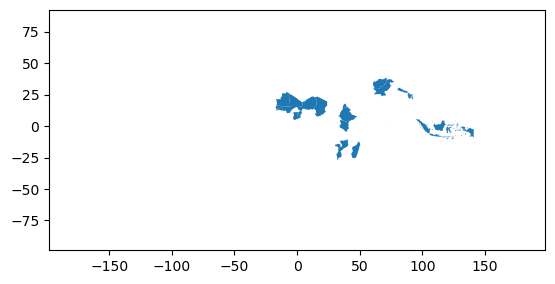

In [134]:
base=worldBorders.plot(color='white')
interestingCountries.plot(ax=base)


## About color palettes

The default is _viridis_:

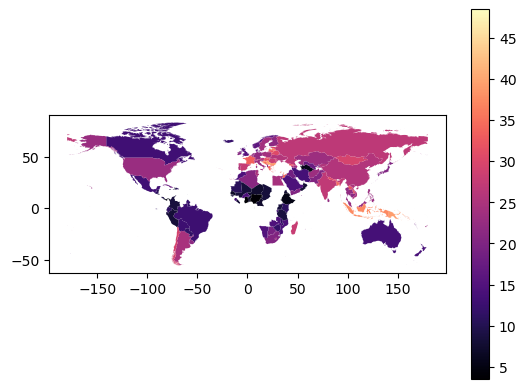

In [26]:
countriesCIA.plot(column='TobaccoUse_perc',legend=True,cmap='magma')
plt.show();

Remember to choose a palette that DOES NOT have **red** and **green** simultaneously, colorblinded people have trouble when both are present.

## About missing values

You should inform what is missing. A good strategy is to create another map of only the borders:

In [27]:
countries.dissolve()

,geometry,COUNTRY
0,"MULTIPOLYGON (((-159.77335 -79.86084, -159.924...",Aruba (Netherlands)


The cell 'Aruba' can be changed to 'world', but it is not really needed. Let me go ahead and create the new map, and use it a as base layer.

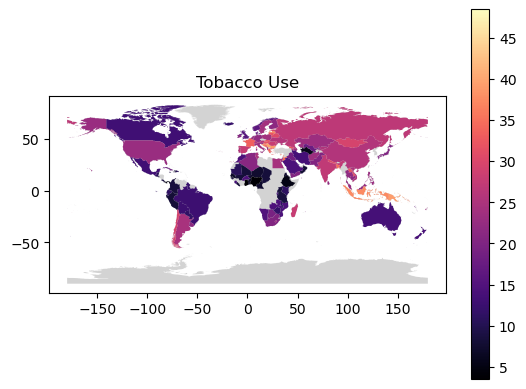

In [28]:
worldBorders=countries.dissolve() # saving the dissolved map

# plotting two layers:
base=worldBorders.plot(color='lightgrey') # layer 1
countriesCIA.plot(column='TobaccoUse_perc',legend=True,cmap='magma',
                  ax=base) # layer 2, on top on layer 1
base.set_title("Tobacco Use")
plt.show();

## About axes coordinates

Coordinates are important, but in some cases they can be omitted. You need to evaluate that on a case by case basis.

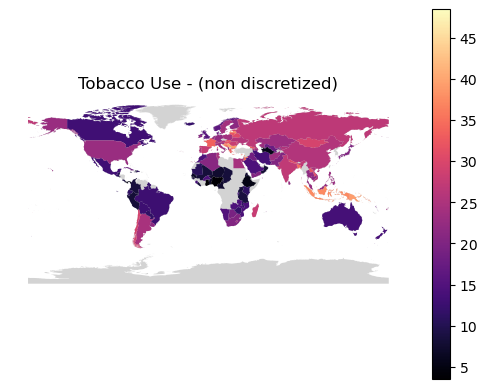

In [29]:
base=worldBorders.plot(color='lightgrey')
countriesCIA.plot(column='TobaccoUse_perc',
                  legend=True,
                  cmap='magma',
                  ax=base)
# here!
base.set_title("Tobacco Use - (non discretized)")
base.set_axis_off()


plt.show();

**I will share the code to create this last map in R too.**


## A Choropleth for DISCRETIZED values


Discretizing is about cutting the variable in intervals. This is a usual operation, which is used by histogramas to compute the width of each bin:



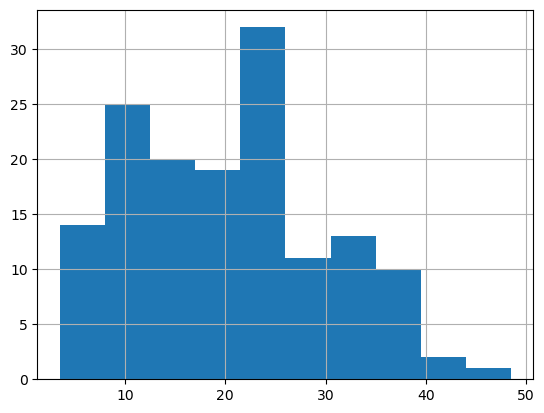

In [30]:
countriesCIA.loc[:,'TobaccoUse_perc'].hist()
plt.show();

For histograms, 10 bins is the default, and generally that is a good idea; but in maps we should try 3 or 5.

## The bining schemes

Let me compute 5 bins using different schemes:

In [71]:
## make sure you have
# !pip show pysal mapclassify numpy

In [32]:
import mapclassify
import numpy as np

np.random.seed(12345) # so we all get the same results!

# let's try 5 bins
K=5
theVar=countriesCIA.TobaccoUse_perc


# same interval width, easy interpretation
ei5 = mapclassify.EqualInterval(theVar, k=K)
# same interval width based on standard deviation, easy - but not as the previous one, poor when high skewness
msd = mapclassify.StdMean(theVar)
# interval width varies, counts per interval are close, not easy to grasp, repeated values complicate cuts
q5=mapclassify.Quantiles(theVar,k=K)
# based on similarity, good for multimodal data
mb5 = mapclassify.MaximumBreaks(theVar, k=K)
# based on similarity, optimizer
fj5 = mapclassify.FisherJenks(theVar, k=K)
# based on similarity, optimizer
jc5 = mapclassify.JenksCaspall(theVar, k=K)
# based on similarity, optimizer
mp5 = mapclassify.MaxP(theVar, k=K)

###### based on similarity, good for skewed data
ht = mapclassify.HeadTailBreaks(theVar) # no K needed


How can we select the right classification?
Let me use the the Absolute deviation around class median (ADCM) to make the comparisson:

In [33]:
class5 = ei5,msd, q5,mb5,  ht, fj5, jc5, mp5
# Collect ADCM for each classifier
fits = np.array([ c.adcm for c in class5])
# Convert ADCM scores to a DataFrame
adcms = pd.DataFrame(fits)
# Add classifier names
adcms['classifier'] = [c.name for c in class5]
# Add column names to the ADCM
adcms.columns = ['ADCM', 'Classifier']

Now, plot the **adcms**:

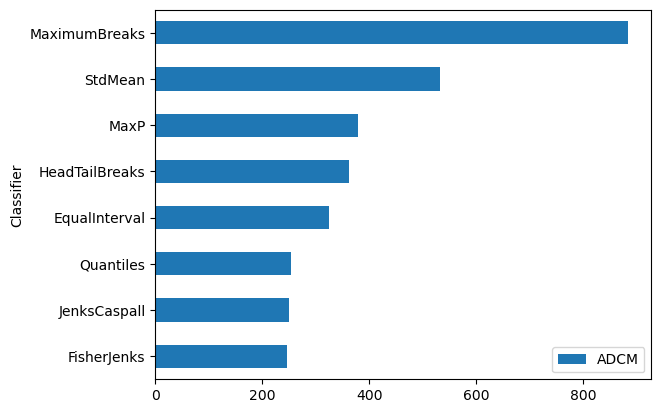

In [34]:
adcms.sort_values('ADCM').plot.barh(x='Classifier')
plt.show();

As you see, the best scheme is '[Fisher Jenks](https://pbpython.com/natural-breaks.html)'. Then, we can request that in the plot:

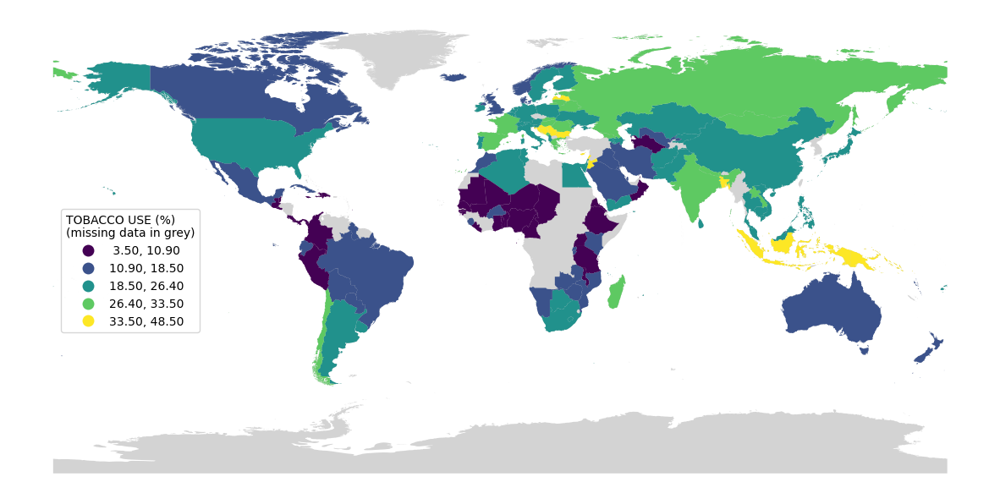

In [35]:
base=worldBorders.plot(color='lightgrey',
                     figsize=(15, 10))
countriesCIA.plot(column='TobaccoUse_perc', cmap='viridis', ax=base,
                     scheme="fisher_jenks",
                     linewidth=0.,
                     legend=True,
                     legend_kwds={"title": "TOBACCO USE (%)\n(missing data in grey)"}
                   )
leg = base.get_legend()
leg.set_bbox_to_anchor((0.2, 0.6)) #(left, bottom)
base.set_axis_off()
plt.show();


Above you see the bins limits that Fisher Jenks gave you.  

In [36]:
# the code assigned to each country
fj5.yb

array([2, 2, 2, 2, 2, 3, 2, 1, 2, 1, 0, 2, 2, 4, 0, 4, 1, 0, 3, 4, 1, 4,
       1, 1, 1, 2, 0, 2, 2, 3, 0, 2, 0, 0, 1, 4, 1, 0, 1, 2, 2, 3, 0, 0,
       0, 2, 2, 3, 3, 0, 2, 3, 0, 1, 0, 4, 3, 1, 3, 1, 2, 2, 1, 2, 0, 4,
       1, 2, 4, 1, 2, 3, 4, 4, 3, 0, 3, 2, 2, 3, 3, 3, 0, 0, 1, 2, 0, 2,
       0, 2, 3, 1, 2, 1, 0, 1, 0, 2, 1, 3, 4, 1, 1, 0, 2, 2, 0, 2, 4, 0,
       1, 3, 2, 3, 1, 1, 2, 2, 0, 2, 1, 1, 3, 4, 2, 2, 2, 3, 0, 0, 2, 4,
       0, 0, 0, 1, 2, 2, 1, 2, 1, 2, 1, 2, 1, 1, 4])

In [37]:
# the frequency table with the breaks
fj5.table

<bound method MapClassifier.table of FisherJenks

   Interval      Count
----------------------
[ 3.50, 10.90] |    31
(10.90, 18.50] |    34
(18.50, 26.40] |    46
(26.40, 33.50] |    21
(33.50, 48.50] |    15>

### Recoding and labelling

We can use that information to create an ordinal variable:

In [38]:
# new variable
countriesCIA['tobacco_code']=fj5.yb

# create 'tobacco_levels' as a copy of 'tobacco_code'
countriesCIA=countriesCIA.assign(tobacco_levels=countriesCIA.tobacco_code)

Notice that I have two new columns with the same information.

Now, let's give labels to one of them:

In [39]:
# map of labels for the levels
newLevels={0:'1.very low',1:'2.low', 2:'3.average',3:'4.high', 4:'5.very high'}

# recoding
countriesCIA.replace({'tobacco_levels':newLevels}, inplace=True)

This is our new plot using the _diverging_ palette **PiYG** (I added **_r** to reverse the color order):

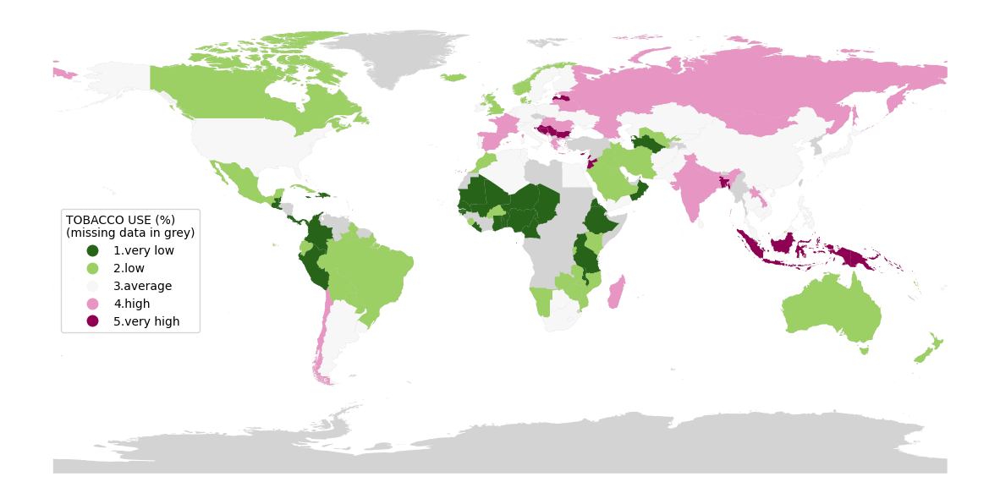

In [40]:
base=worldBorders.plot(color='lightgrey',
                     figsize=(15, 10))
countriesCIA.plot(column='tobacco_levels',ax=base,
                     cmap='PiYG_r', # reversed
                     categorical=True,
                     linewidth=0.,
                     legend=True,
                     legend_kwds={"title": "TOBACCO USE (%)\n(missing data in grey)"}
                   )
base.set_axis_off()

# locating the legend
leg = base.get_legend()
leg.set_bbox_to_anchor((0.2, 0.6)) #(left, bottom), 1 is max value (right/top)

plt.show();


**I will share the R version for this map**.

### Custom bins

Remember that we should always consider custom made bins, instead of "automatically" detected ones. This is important when some thresholds are institutionalised. The process is simple:

* Check values:

In [41]:
countriesCIA.TobaccoUse_perc.describe()

count    147.000000
mean      20.278231
std        9.723848
min        3.500000
25%       11.900000
50%       20.800000
75%       26.100000
max       48.500000
Name: TobaccoUse_perc, dtype: float64

* Decide breaks:

In [42]:
customBreaks=[0,5,15,30,40,100]
pd.cut(countriesCIA.TobaccoUse_perc, customBreaks,ordered=True,include_lowest=True).value_counts(sort=False)

TobaccoUse_perc
(-0.001, 5.0]     3
(5.0, 15.0]      51
(15.0, 30.0]     66
(30.0, 40.0]     25
(40.0, 100.0]     2
Name: count, dtype: int64

* Save the new column with labels:

In [43]:
theCustomLabels=['1. below5','2.(5-15]','3.(15-30]','4. (30-40]' , '5. above40']
countriesCIA['tobacco_custom']=pd.cut(countriesCIA.TobaccoUse_perc,
                                         customBreaks,
                                         ordered=True,
                                         include_lowest=True,
                                         labels=theCustomLabels)
countriesCIA.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 147 entries, 0 to 146
Data columns (total 10 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   COUNTRY               147 non-null    object  
 1   geometry              147 non-null    geometry
 2   name                  147 non-null    object  
 3   region                147 non-null    object  
 4   obesityAdults_rate    147 non-null    float64 
 5   TobaccoUse_perc       147 non-null    float64 
 6   Alcohol_LitersPerCap  147 non-null    float64 
 7   tobacco_code          147 non-null    int32   
 8   tobacco_levels        147 non-null    object  
 9   tobacco_custom        147 non-null    category
dtypes: category(1), float64(3), geometry(1), int32(1), object(4)
memory usage: 10.2+ KB


### Interactive version

Interactive choropleths are important not because they may seem impressive, but because you need them to help you inform values as you visit a polygon (**tooltips**), and if you need to zoom in and out constantly.

An interactive version follows:

In [45]:
pip install folium matplotlib mapclassify

In [47]:
countriesCIA.explore(
    column="tobacco_levels",  # make choropleth based on "fisherJenks_levels" column
    tooltip=["name","TobaccoUse_perc"],  # what to show on hover
    tiles="CartoDB positron",  # use "CartoDB positron" tiles
    cmap="PiYG_r",  # colormap
    style_kwds=dict(color="black"),  # use black outline
    legend_kwds={'caption':'Tobacco Use<br>(missing has no tooltip)'}
)

**Behind the scenes, geopandas is using folium. The code I will share in R will use leaflet for interactive features.**

## Creating layers from the discrete values

Let me subset the map with CIA data:

In [48]:
countriesCIA_good=countriesCIA[countriesCIA.tobacco_code==0]
countriesCIA_mean=countriesCIA[countriesCIA.tobacco_code==2]

Now, plot them in one map:

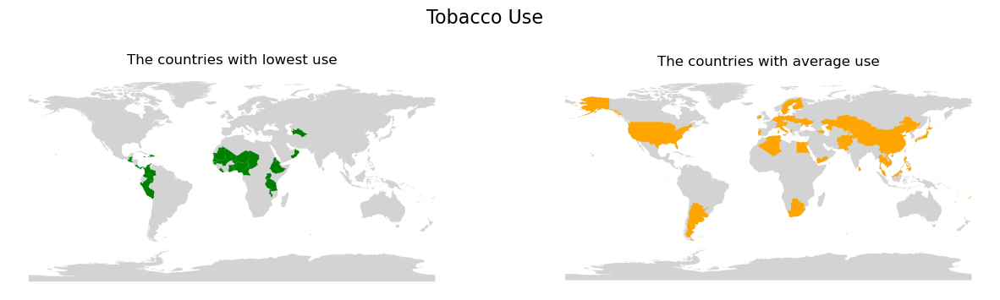

In [49]:
fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(15, 10))
# main title
fig.suptitle('Tobacco Use', size=16,y=0.7)

# map1
base1=worldBorders.plot(color='lightgrey',ax=axes[0])
countriesCIA_good.plot(color='green',ax=base1)
base1.set_title('The countries with lowest use')
base1.set_axis_off()

#map2
base2=worldBorders.plot(color='lightgrey',ax=axes[1])
countriesCIA_mean.plot(color='orange',ax=base2)
base2.set_title('The countries with average use')
base2.set_axis_off()


#display
plt.show();

**I will share the R code for this last map in R, using facets**.

Let me use ONE map to represent the previous one (with two sub maps)in an interactive way:

In [105]:
import folium # I need folium

base = countriesCIA_good.explore(
    color='green',
    tooltip=["name","TobaccoUse_perc"],  # what to show on hover
    name="good",  # name of the layer in the map
)

countriesCIA_mean.explore(
    m=base,  # the 'ax'
    tooltip=["name","TobaccoUse_perc"],  # what to show on hover
    color="orange",
    name="average",
)


folium.LayerControl().add_to(base)  # use folium to add layer control

base  # show map

Currently we have:

In [107]:
countriesCIA.head()

,COUNTRY,geometry,name,region,obesityAdults_rate,TobaccoUse_perc,Alcohol_LitersPerCap,obesity_code,obesity_levels,obesity_custom
0,Afghanistan,"MULTIPOLYGON (((61.27656 35.60725, 61.29638 35...",Afghanistan,South Asia,5.5,23.3,0.01,0,1.very low,2.(5-15]
1,Algeria,"MULTIPOLYGON (((-5.15213 30.18047, -5.13917 30...",Algeria,Africa,27.4,21.0,0.59,2,3.average,3.(15-30]
2,Azerbaijan,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38...",Azerbaijan,Middle East,19.9,24.0,1.38,1,2.low,3.(15-30]
3,Albania,"MULTIPOLYGON (((20.79192 40.43154, 20.78722 40...",Albania,Europe,21.7,22.4,4.40,1,2.low,3.(15-30]
4,Armenia,"MULTIPOLYGON (((46.54037 38.87559, 46.51639 38...",Armenia,Middle East,20.2,25.5,3.77,1,2.low,3.(15-30]


# Beyond choroplething

At every one of the previous stages you may need to make several assumptions and use a particular technique. At the end, you do all this work not to color a map in a nice way, but to give some interesting information that may start a decision making process. Most of the time, these requires combining several variables to say something relevant.

Let's prepare the bins for the _Alcohol_ data, and then propose something interesting.

In [120]:
# based on similarity, optimizer
fj5_alc = mapclassify.FisherJenks(countriesCIA.Alcohol_LitersPerCap, k=K)

# get the values
countriesCIA['alcohol_code']=fj5_alc.yb

# a copy in another column
countriesCIA=countriesCIA.assign(alcohol_levels=countriesCIA.alcohol_code)

# recoding
countriesCIA.replace({'alcohol_levels':newLevels}, inplace=True)

countriesCIA.head()

,COUNTRY,geometry,name,region,obesityAdults_rate,TobaccoUse_perc,Alcohol_LitersPerCap,obesity_code,obesity_levels,obesity_custom,alcohol_code,alcohol_levels
0,Afghanistan,"MULTIPOLYGON (((61.27656 35.60725, 61.29638 35...",Afghanistan,South Asia,5.5,23.3,0.01,0,1.very low,2.(5-15],0,1.very low
1,Algeria,"MULTIPOLYGON (((-5.15213 30.18047, -5.13917 30...",Algeria,Africa,27.4,21.0,0.59,2,3.average,3.(15-30],0,1.very low
2,Azerbaijan,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38...",Azerbaijan,Middle East,19.9,24.0,1.38,1,2.low,3.(15-30],0,1.very low
3,Albania,"MULTIPOLYGON (((20.79192 40.43154, 20.78722 40...",Albania,Europe,21.7,22.4,4.40,1,2.low,3.(15-30],2,3.average
4,Armenia,"MULTIPOLYGON (((46.54037 38.87559, 46.51639 38...",Armenia,Middle East,20.2,25.5,3.77,1,2.low,3.(15-30],1,2.low


This is the distribution:

In [121]:
countriesCIA.alcohol_levels.value_counts()

alcohol_levels
1.very low     45
2.low          31
5.very high    26
4.high         24
3.average      21
Name: count, dtype: int64

Now that we have two variables, we could ask ourselves _what countries are high (level 4) in both tobacco and alcohol consumption_?

In [125]:
print(countriesCIA.columns)

Index(['COUNTRY', 'geometry', 'name', 'region', 'obesityAdults_rate',
       'TobaccoUse_perc', 'Alcohol_LitersPerCap', 'obesity_code',
       'obesity_levels', 'obesity_custom', 'alcohol_code', 'alcohol_levels'],
      dtype='object')


In [122]:
interestingCountries=countriesCIA[countriesCIA.tobacco_code + countriesCIA.alcohol_code==8]
## or
# countriesCIA[(countriesCIA.tobacco_code==4) & (countriesCIA.alcohol_code==4)]

interestingCountries

AttributeError: 'GeoDataFrame' object has no attribute 'tobacco_code'

These are the countries:

ValueError: aspect must be finite and positive 

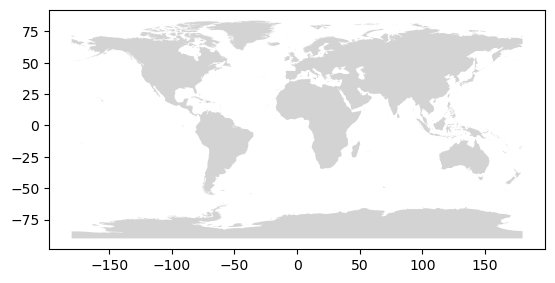

In [123]:
base=worldBorders.plot(color='lightgrey')
interestingCountries.plot(ax=base)

Here we need to alter the basemap for an area like this:

In [ ]:
countriesCIA[countriesCIA.tobacco_code + countriesCIA.alcohol_code==8].plot()

All those polygons are within a rectangle, let me find it:

In [ ]:
maskToClip=interestingCountries.dissolve().envelope
maskToClip.plot(color='white',edgecolor='red')

I may use this rectangle to clip the world!

In [124]:
# new map
miniWorld=worldBorders.clip(maskToClip)
# then
base=miniWorld.plot(color='lightgrey')

interestingCountries.plot(ax=base)
plt.show()

NameError: name 'maskToClip' is not defined

It would be better if we can see the names. Here comes some labor:
1. Get the coordinates for the country names

In [ ]:
allCoords=[x.coords[:][0] for x in interestingCountries.representative_point()]
allCoords

2. Use those coordinates to create a new column:

In [ ]:
interestingCountries=interestingCountries.assign(coordinates=allCoords)
interestingCountries

Let's use that info:

In [ ]:
base=miniWorld.plot(color='lightgrey')
interestingCountries.plot(color='yellow', edgecolor='black',ax=base)
for idx, row in interestingCountries.iterrows():
   plt.annotate(text=row['name'], xy=row['coordinates'], horizontalalignment='center', color='blue')

**You will find the code in R for this one too**.

The interactive version does not need the clipped map:

In [ ]:
interestingCountries.explore()

From here, you can start hypothesing some ideas where location matters (why are you usig a map otherwise!)

Let me save this information in a geopackage file:

In [ ]:
countriesCIA.info()

In [ ]:
countriesCIA.to_file('maps/countriesCIA.gpkg', driver='GPKG', layer='cia')
worldBorders.to_file('maps/countriesCIA.gpkg', driver='GPKG', layer='border')

# HOMEWORK #1

You will work with obesity (obesityAdults_rate), as we did with tobacco and alcohol variables.
See details in CANVAS!